In [ ]:
print("Interactive analysis notebook for decoding results")
import sys
from pathlib import Path

project_root = Path.cwd().parent  
if str(project_root) not in sys.path:
    sys.path.insert(0, str(project_root))
import importlib
import pandas as pd

import linguistics.figures.plotting as plotting
importlib.reload(plotting)

Interactive analysis notebook for decoding results


<module 'linguistics.figures.plotting' from '/projects/DS-LINGUISTICS-MEG-MASC/linguistics/figures/plotting.py'>

In [5]:
decoding_roots = Path("../output/19-10-2025-18-13")
# Fixed glob pattern - use * instead of +
matching_files = list(decoding_roots.glob("[0-9][0-9]_chunk[0-9]*_decoding_results.csv"))
print(f"Found {len(matching_files)} decoding result files.")
result_df = pd.DataFrame()
for file in matching_files:
    try:
        df = pd.read_csv(file)
    except Exception as e:
        print(f"Error reading {file}: {e}")
        continue
    result_df = pd.concat([result_df, df], ignore_index=True)
print(f"Combined dataframe shape: {result_df.shape}")
all_subjects_df = result_df

Found 69 decoding result files.
Error reading ../output/19-10-2025-18-13/11_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/07_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/06_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/02_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/08_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/10_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/04_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/05_chunk6_decoding_results.csv: No columns to parse from file
Error reading ../output/19-10-2025-18-13/09_chunk6_decoding_results.csv: No columns to parse from file
Combined dataframe shape: (362880, 6)


In [6]:
features = all_subjects_df['contrast'].unique()
features

array(['manner_a', 'manner_f', 'manner_n', 'manner_o', 'manner_v',
       'frontback_b', 'frontback_f', 'part_of_speach_ADJ',
       'part_of_speach_ADP', 'part_of_speach_ADV', 'part_of_speach_AUX',
       'part_of_speach_CCONJ', 'part_of_speach_DET',
       'part_of_speach_INTJ', 'part_of_speach_NOUN', 'part_of_speach_NUM',
       'part_of_speach_PART', 'part_of_speach_PRON',
       'part_of_speach_PROPN', 'part_of_speach_SCONJ',
       'part_of_speach_VERB', 'phonation_uv', 'phonation_v',
       'centrality_c', 'centrality_f', 'centrality_n', 'roundness_r',
       'roundness_u'], dtype=object)

In [7]:
# group by feature type
manner_features = [f for f in features if f.startswith('manner')]
rounded_features = [f for f in features if f.startswith('roundedness')]
front_features = [f for f in features if f.startswith('frontness')]
phonation_features = [f for f in features if f.startswith('phonation')]
centrality_features = [f for f in features if f.startswith('centrality')]

In [8]:
all_subjects_df.head()
# Exclude subject 10 due to data issues
all_subjects_df = all_subjects_df[all_subjects_df['subject'] != 10]

In [9]:
# Plot manner features for a specific subject
'''
for selected_subject_id in all_subjects_df['subject'].unique():
    for feature_name in manner_features:
        subject_df = all_subjects_df[all_subjects_df['subject'] == selected_subject_id]
        if not subject_df.empty:
            print(f"Processing feature: {feature_name} for subject ID: {selected_subject_id}")
            print(subject_df['contrast'].unique())
            subjects_filtered_by_feature = subject_df[subject_df['contrast'].str.startswith(feature_name)]
            print(subjects_filtered_by_feature['contrast'].unique())
            plotting.plot_feature_comparison(subjects_filtered_by_feature, feature=feature_name, save_path=f"../output/feature_comparison_plot_subject_id_{selected_subject_id}_feature_name_{feature_name}.png")
'''

'\nfor selected_subject_id in all_subjects_df[\'subject\'].unique():\n    for feature_name in manner_features:\n        subject_df = all_subjects_df[all_subjects_df[\'subject\'] == selected_subject_id]\n        if not subject_df.empty:\n            print(f"Processing feature: {feature_name} for subject ID: {selected_subject_id}")\n            print(subject_df[\'contrast\'].unique())\n            subjects_filtered_by_feature = subject_df[subject_df[\'contrast\'].str.startswith(feature_name)]\n            print(subjects_filtered_by_feature[\'contrast\'].unique())\n            plotting.plot_feature_comparison(subjects_filtered_by_feature, feature=feature_name, save_path=f"../output/feature_comparison_plot_subject_id_{selected_subject_id}_feature_name_{feature_name}.png")\n'

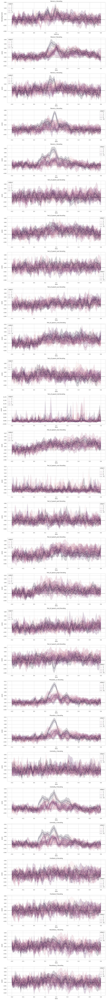

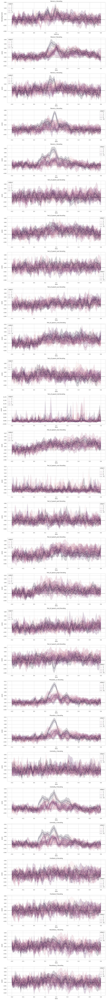

In [ ]:
#plotting.plot_comparison_subjects(all_subjects_df, save_path="../output/comparison_plot.png")

In [17]:
all_subjects_df.head()

,score,time,label,n,contrast,subject
0,0.027188,-0.20,t0_s0_h0,904.0,manner_a,2
1,0.081833,-0.19,t0_s0_h0,904.0,manner_a,2
2,0.005180,-0.18,t0_s0_h0,904.0,manner_a,2
3,0.014698,-0.17,t0_s0_h0,904.0,manner_a,2
4,0.036964,-0.16,t0_s0_h0,904.0,manner_a,2


Calculating median scores...
Filtering for phonetic features...
Generating Phonetic-Only Clustermap (Y-axis only)...


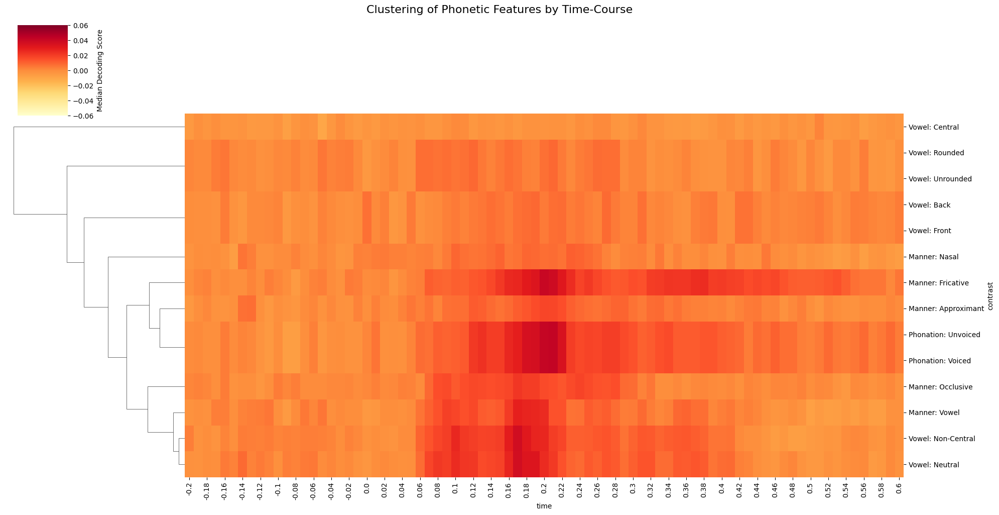

Clustermap saved.


In [10]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Shared scale for R-values across heatmaps
vmin = -0.06
vmax = 0.06

label_map = {
    'manner_a': 'Manner: Approximant',
    'manner_f': 'Manner: Fricative',
    'manner_n': 'Manner: Nasal',
    'manner_o': 'Manner: Occlusive',
    'manner_v': 'Manner: Vowel',
    'phonation_uv': 'Phonation: Unvoiced',
    'phonation_v': 'Phonation: Voiced',
    'centrality_c': 'Vowel: Central',
    'centrality_f': 'Vowel: Non-Central',
    'centrality_n': 'Vowel: Neutral',
    'frontback_b': 'Vowel: Back',
    'frontback_f': 'Vowel: Front',
    'roundness_r': 'Vowel: Rounded',
    'roundness_u': 'Vowel: Unrounded'
}

# 1. Create the Median Dataframe
print("Calculating median scores...")
median_df = all_subjects_df.groupby(['contrast', 'time'])['score'].median().reset_index()

# 2. Pivot this data to create the 2D matrix for the heatmap
heatmap_data = median_df.pivot(
    index='contrast',  # Y-axis (features)
    columns='time',    # X-axis (time)
    values='score'     # Color (median score)
)

# 3. --- NEW: Filter for Phonetic Features Only ---
print("Filtering for phonetic features...")
all_features = heatmap_data.index
# Select all rows that do NOT start with 'part_of_speach_'
phonetic_features = [f for f in all_features if not f.startswith('part_of_speach_')]

# Create the new, filtered dataframe and drop any empty rows
phonetic_heatmap_data = heatmap_data.loc[phonetic_features].dropna()
phonetic_heatmap_data = phonetic_heatmap_data.rename(index=label_map)

# 4. --- MODIFIED: Clustermap (Y-axis only) ---
print("Generating Phonetic-Only Clustermap (Y-axis only)...")

# This one function does the clustering and the heatmap
g = sns.clustermap(
    phonetic_heatmap_data,  # Use the *filtered* data
    
    # --- KEY CHANGES ---
    row_cluster=True,       # Cluster the Y-axis (features)
    col_cluster=False,      # DO NOT cluster the X-axis (time)
    
    method='average',       # Clustering algorithm
    metric='correlation',   # Cluster by similarity
    cmap="YlOrRd",
    center=0.0,
    vmin=vmin,
    vmax=vmax,
    cbar_kws={'label': 'Median Decoding Score'},
    figsize=(20, 10)      # Adjust size as needed
)

# Rotate the x-axis labels to be readable
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=90)
plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0) # Ensure y-labels are horizontal

# Set the title
g.fig.suptitle("Clustering of Phonetic Features by Time-Course", fontsize=16, y=1.02)

# Save the final, clustered figure
plt.savefig("../output/FINAL_PLOT_CLUSTERMAP_phonetic_only.png", dpi=300, bbox_inches='tight')
plt.show()

print("Clustermap saved.")

Calculating median scores...
Filtering for Part-of-Speech features...
Generating Part-of-Speech Clustermap (Y-axis only)...


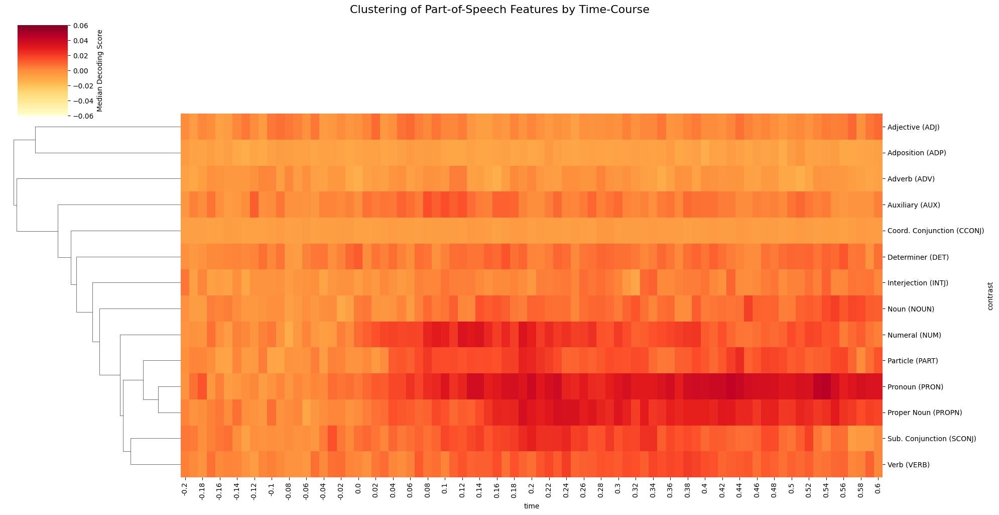

Part-of-Speech Clustermap saved.


In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Shared scale for R-values across heatmaps
vmin = -0.06
vmax = 0.06

# 1. Create the Median Dataframe
print("Calculating median scores...")
median_df = all_subjects_df.groupby(['contrast', 'time'])['score'].median().reset_index()

# 2. Pivot this data to create the 2D matrix for the heatmap
heatmap_data = median_df.pivot(
    index='contrast',  # Y-axis (features)
    columns='time',    # X-axis (time)
    values='score'     # Color (median score)
)

# 3. --- NEW: Filter for Part-of-Speech Features Only ---
print("Filtering for Part-of-Speech features...")
all_features = heatmap_data.index
# Select all rows that *DO* start with 'part_of_speach_'
pos_features = [f for f in all_features if f.startswith('part_of_speach_')]

# Create the new, filtered dataframe and drop any empty rows
pos_heatmap_data = heatmap_data.loc[pos_features].dropna()
label_map = {
    'part_of_speach_ADJ': 'Adjective (ADJ)',
    'part_of_speach_ADP': 'Adposition (ADP)',
    'part_of_speach_ADV': 'Adverb (ADV)',
    'part_of_speach_AUX': 'Auxiliary (AUX)',
    'part_of_speach_CCONJ': 'Coord. Conjunction (CCONJ)',
    'part_of_speach_DET': 'Determiner (DET)',
    'part_of_speach_INTJ': 'Interjection (INTJ)',
    'part_of_speach_NOUN': 'Noun (NOUN)',
    'part_of_speach_NUM': 'Numeral (NUM)',
    'part_of_speach_PART': 'Particle (PART)',
    'part_of_speach_PRON': 'Pronoun (PRON)',
    'part_of_speach_PROPN': 'Proper Noun (PROPN)',
    'part_of_speach_SCONJ': 'Sub. Conjunction (SCONJ)',
    'part_of_speach_VERB': 'Verb (VERB)'
}
# Filter the map to only include features we actually have
filtered_label_map = {k: v for k, v in label_map.items() if k in pos_heatmap_data.index}

# 5. --- NEW: Apply the labels ---
pos_heatmap_data_renamed = pos_heatmap_data.rename(index=filtered_label_map)

# 4. --- MODIFIED: Clustermap (Y-axis only) ---
print("Generating Part-of-Speech Clustermap (Y-axis only)...")

# This one function does the clustering and the heatmap
g = sns.clustermap(
    pos_heatmap_data_renamed,  # Use the *filtered* data
    
    # --- KEY CHANGES ---
    row_cluster=True,       # Cluster the Y-axis (features)
    col_cluster=False,      # DO NOT cluster the X-axis (time)
    
    method='average',       # Clustering algorithm
    metric='correlation',   # Cluster by similarity
    cmap="YlOrRd",
    center=0.0,
    vmin=vmin,
    vmax=vmax,
    cbar_kws={'label': 'Median Decoding Score'},
    figsize=(20, 10)      # Adjust size as needed
)

# Rotate the x-axis labels to be readable
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=90)
# --- Set the new human-readable Y-labels ---
g.ax_heatmap.set_yticklabels(pos_heatmap_data_renamed.index, rotation=0)

# Set the title
g.fig.suptitle("Clustering of Part-of-Speech Features by Time-Course", fontsize=16, y=1.02)

# Save the final, clustered figure
plt.savefig("../output/FINAL_PLOT_CLUSTERMAP_pos_only.png", dpi=300, bbox_inches='tight')
plt.show()

print("Part-of-Speech Clustermap saved.")